In [1]:
#Nivel de ruido
n_scans = 1
inhomogeneidades_var = 'no' #si/no
BM4D = 'si' #si/no

#Si queremos que quite n slices del principio y fin para evitar imágenes oscuras
quitar_slices = 4

#Augmentation
augmentation = 'si' #si/no
flipleft = "si"
flipupdown = "si"
zoom = "si"

SEED = 50

In [2]:
import tensorflow

C:\Users\usuario\anaconda3\lib\site-packages\numpy\_distributor_init.py:30: UserWarning: loaded more than 1 DLL from .libs:
C:\Users\usuario\anaconda3\lib\site-packages\numpy\.libs\libopenblas.EL2C6PLE4ZYW3ECEVIV3OXXGRN2NRFM2.gfortran-win_amd64.dll
C:\Users\usuario\anaconda3\lib\site-packages\numpy\.libs\libopenblas64__v0.3.21-gcc_10_3_0.dll
  warnings.warn("loaded more than 1 DLL from .libs:"


In [3]:
import numpy
print(numpy.__version__)

1.24.2


In [4]:
tensorflow.config.experimental.set_memory_growth(tensorflow.config.list_physical_devices('GPU')[0], True)

In [5]:
import scipy.io
import os
#import fastmri
#from fastmri.data import transforms as T
import numpy as np
from matplotlib import pyplot as plt
import random

import tensorflow
from tensorflow.keras import layers
from tensorflow.keras.layers import BatchNormalization

import math

from skimage.metrics import structural_similarity as ssim

from sklearn.model_selection import train_test_split

from random import randint

import matplotlib.patches as patches
from bm4d import bm4d

import cv2 as cv

from datetime import datetime 
import time

import utils

In [6]:
os.getcwd()

'C:\\Users\\usuario\\Desktop\\TFM\\TFM_ordenador_FER\\physio_MRI\\physio_code\\AE_Physio\\autoencoder'

## Load images

In [7]:
direct='../../../../Naranjas'

In [8]:
#Accedemos a los files 
files = os.listdir(direct)
files

['.ipynb_checkpoints',
 'Old_RARE.2022.01.19.18.52.47.mat',
 'Old_RARE.2022.01.19.22.12.37.mat',
 'Old_RARE.2022.01.20.12.52.00.mat',
 'Old_RARE.2022.01.20.14.55.29.mat',
 'Old_RARE.2022.01.20.19.57.03.mat',
 'Old_RARE.2022.01.21.12.59.51.mat',
 'Old_RARE.2022.01.21.15.20.37.mat',
 'Old_RARE.2022.01.21.17.34.17.mat',
 'Old_RARE.2022.01.21.21.45.18.mat',
 'Old_RARE.2022.01.25.15.34.49.mat']

In [9]:
# Para ver cual es el máximo número de scans
mats = os.listdir(direct)
number_scans = []

for i in mats:
    if 'checkpoints' in i:
        continue
    else:
        naranja_mat = scipy.io.loadmat(direct + '/' + i)
        naranja = naranja_mat['imgFull']
        number_scans.append(naranja.shape[0])

print('El mayor número de scans es: ', max(number_scans))
print('number_scans: ')
print(number_scans)

El mayor número de scans es:  16
number_scans: 
[16, 16, 16, 16, 16, 16, 16, 16, 16, 16]


In [10]:
#Codigo para cargar images y images_noise
images=[]
images_noise=[]

for i in mats:
    if 'checkpoints' in i:
        continue
    else:    
        naranja_mat = scipy.io.loadmat(direct + '/' + i)
        naranja = naranja_mat['imgFull']

        naranja_GT = np.mean(naranja, axis=0)
        naranja_noise = naranja[0:n_scans,:,:,:]
        naranja_noise = np.mean(naranja_noise, axis=0)

        images.append(naranja_GT)
        images_noise.append(naranja_noise)

print(len(images))
print(len(images_noise))

10
10


In [11]:
for i in images:
    print(i.shape)

for i in images_noise:
    print(i.shape)

(26, 160, 160)
(26, 160, 160)
(26, 160, 160)
(26, 160, 160)
(26, 160, 160)
(26, 160, 160)
(26, 160, 160)
(26, 160, 160)
(26, 160, 160)
(26, 160, 160)
(26, 160, 160)
(26, 160, 160)
(26, 160, 160)
(26, 160, 160)
(26, 160, 160)
(26, 160, 160)
(26, 160, 160)
(26, 160, 160)
(26, 160, 160)
(26, 160, 160)


## Pipeline for Train

In [12]:
#Funcion de pad y slice teniendo en cuenta la dim de los slice
#(Ahora mismo la función NO transforma de k-space a im)
def image_space_slice(physio_im):
    images = []
    n_append=0
    
    for j in physio_im:
        
        volume_kspace = j

        #list of slice in absolute value image space
        #Dimensión donde se encuentra el min
        shape=np.array(volume_kspace.shape)
        for k in list(range(volume_kspace.ndim)):
            if shape[k] == min(shape):
                dim_10 = k

        n_slice = min(shape)
        for i in list(range(quitar_slices, n_slice-quitar_slices)):

            #for m in list(range(min(shape))): 
            if dim_10 == 0:
                slice_kspace = volume_kspace[i,:,:]
            elif dim_10 == 1: 
                slice_kspace = volume_kspace[:,i,:]
            elif dim_10 == 2: 
                slice_kspace = volume_kspace[:,:,i]  
           
            #slice_kspace2 = T.to_tensor(slice_kspace)      # Convert from numpy array to pytorch tensor
            #slice_image = fastmri.ifft2c(slice_kspace2)

            #slice_image_abs = fastmri.complex_abs(slice_image)   # Compute absolute value to get a real image
            #data = np.array(slice_image_abs)
            data = np.array(slice_kspace)
            data = abs(data)
            images.append(data)

    images=np.asarray(images)
    return images

In [13]:
images=image_space_slice(images)
images_noise=image_space_slice(images_noise)

In [14]:
print(images.shape)
print(images_noise.shape)

(180, 160, 160)
(180, 160, 160)


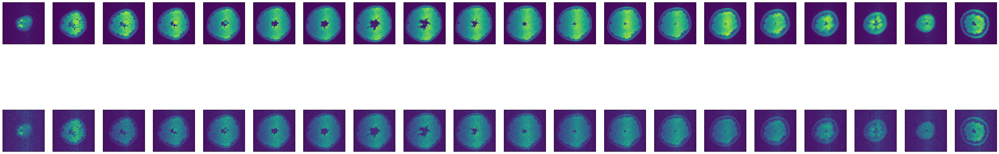

In [15]:
n = 20
z = 35
fig, axs = plt.subplots(2,n, figsize=(50,10))
for i in range(0, n):
    axs[0, i].imshow((images[i+z].reshape(images.shape[1], images.shape[1])))
    axs[0, i].get_xaxis().set_visible(False)
    axs[0, i].get_yaxis().set_visible(False)   
    
    axs[1, i].imshow(images_noise[i+z].reshape(images.shape[1], images.shape[1]))
    axs[1, i].get_xaxis().set_visible(False)
    axs[1, i].get_yaxis().set_visible(False)  
#plt.subplots_adjust(top = 0.2, bottom=0.01, hspace=-0.3, wspace=0.1)
#fig.tight_layout()
plt.gray()
plt.show()

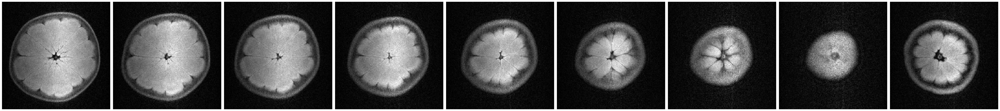

In [16]:
n = 20
z = 46
fig, axs = plt.subplots(1,9, figsize=(50,10))
for i,j in zip(range(0, 9),[0,1,2,3,4,5,6,7,8,9]):
    axs[i].imshow((images[j+z].reshape(images.shape[1], images.shape[1])))
    axs[i].get_xaxis().set_visible(False)
    axs[i].get_yaxis().set_visible(False)   
    
    #axs[1, i].imshow(images_noise[i+z].reshape(images.shape[1], images.shape[1]))
    #axs[1, i].get_xaxis().set_visible(False)
    #axs[1, i].get_yaxis().set_visible(False)  
#plt.subplots_adjust(top = 0.2, bottom=0.01, hspace=-0.3, wspace=0.1)
fig.tight_layout()
plt.gray()
plt.show()

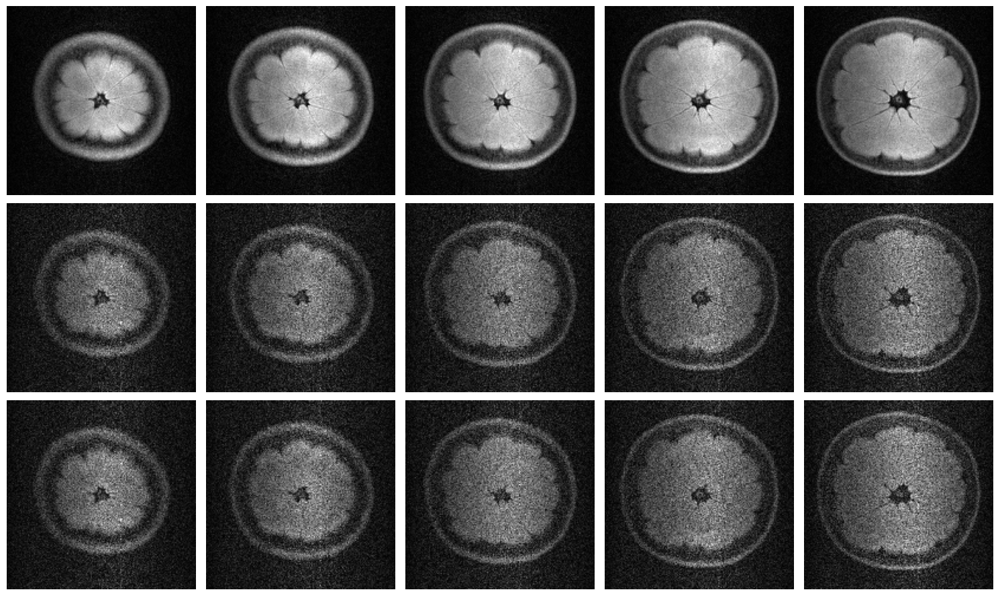

In [17]:
utils.show_image(images, images_noise, images_noise)

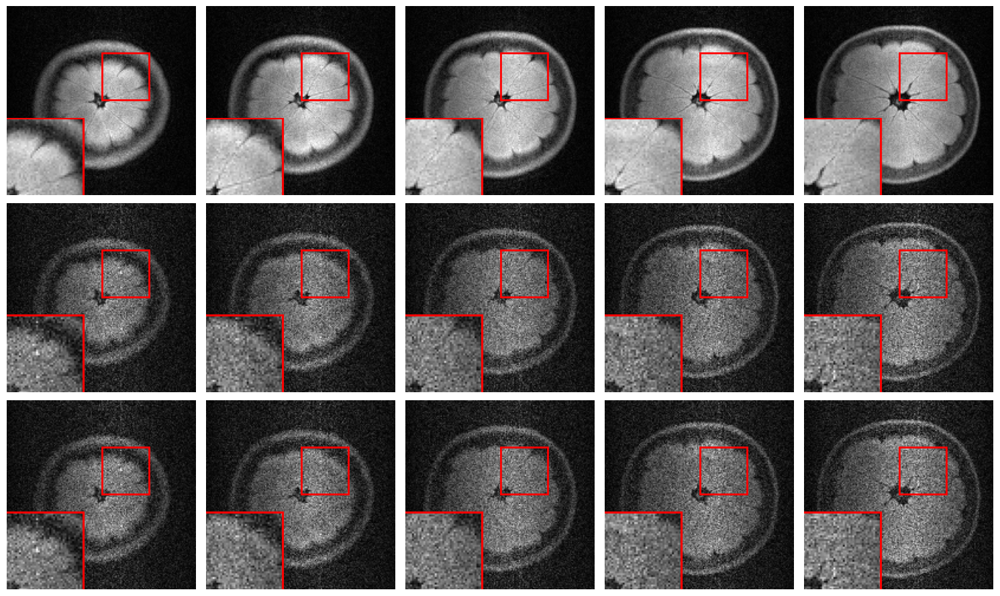

In [18]:
utils.show_windows_image(images, images_noise, images_noise)

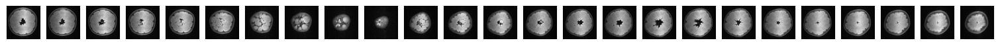

In [19]:
#Para comprobar que no haya slices oscuros
n = 26
z = 25
plt.figure(figsize=(20, 10))
for i in range(1, n):
    ax = plt.subplot(1, n, i)
    plt.imshow(images[i+z].reshape(images.shape[1], images.shape[1]))
    plt.gray()
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()

### Data Augmentation

In [20]:
import importlib
import data_augmentation
importlib.reload(data_augmentation)


from data_augmentation import data_augmentation_methods

In [21]:
if augmentation == 'si':
    #Time
    start_time = datetime.now() 
    rand = randint(0,10000)
    x_train, x_test = train_test_split(images,
                                       test_size=0.2,
                                       random_state=SEED)

    x_train_noisy, x_test_noisy, index_train_noisy, index_test_noisy = train_test_split(images_noise, np.arange(images_noise.shape[0]),
                                       test_size=0.2,
                                       random_state=SEED)
    x_train_shape0 = x_train.shape[0]
    print(x_train.shape)
    print(x_test.shape)
    
    #Eliminamos las de test
    images_noise = np.delete(images_noise, index_test_noisy, axis=0)
    print(images_noise.shape)
    
    images, images_noise = data_augmentation_methods(mats, direct, quitar_slices, SEED, x_train_shape0, x_train, x_train_noisy, flipleft = flipleft, flipupdown = flipupdown, zoom = zoom)
    #Time
    print(" ")
    print('Time elapsed (hh:mm:ss.ms) {}'.format(datetime.now() - start_time))

(144, 160, 160)
(36, 160, 160)
(144, 160, 160)
(288, 160, 160)
(288, 160, 160)
(432, 160, 160)
(432, 160, 160)
(576, 160, 160)
(576, 160, 160)
 
Time elapsed (hh:mm:ss.ms) 0:00:09.555024


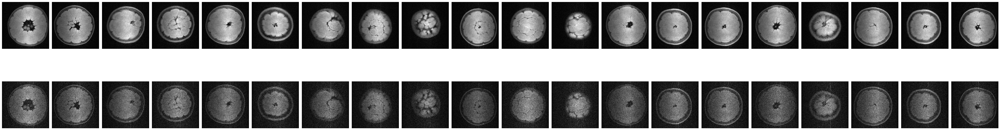

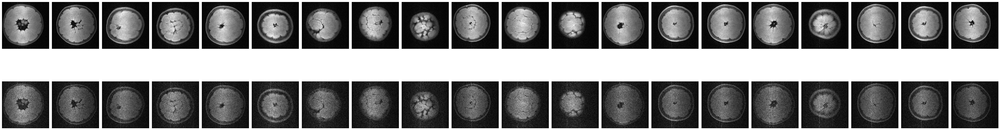

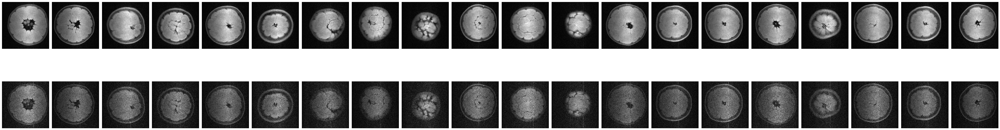

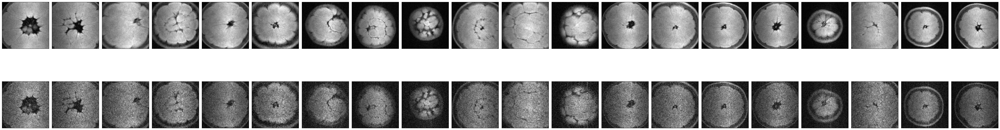

In [22]:
if augmentation == 'si':
    n = 20
    z = 0

    #ORIGINAL
    fig, axs = plt.subplots(2,n, figsize=(50,10))
    for i in range(0, n):
        axs[0, i].imshow((images[i+z].reshape(images.shape[1], images.shape[1])))
        axs[0, i].get_xaxis().set_visible(False)
        axs[0, i].get_yaxis().set_visible(False)   

        axs[1, i].imshow(images_noise[i+z].reshape(images.shape[1], images.shape[1]))
        axs[1, i].get_xaxis().set_visible(False)
        axs[1, i].get_yaxis().set_visible(False)  
    #plt.subplots_adjust(top = 0.2, bottom=0.01, hspace=-0.3, wspace=0.1)
    fig.tight_layout()
    plt.show() 

    #FLIPLEFT (fliptransversal)
    fig, axs = plt.subplots(2,n, figsize=(50,10))
    for i in range(0, n):
        axs[0, i].imshow((images[i+x_train_shape0+z].reshape(images.shape[1], images.shape[1])))
        axs[0, i].get_xaxis().set_visible(False)
        axs[0, i].get_yaxis().set_visible(False)   

        axs[1, i].imshow(images_noise[i+x_train_shape0+z].reshape(images.shape[1], images.shape[1]))
        axs[1, i].get_xaxis().set_visible(False)
        axs[1, i].get_yaxis().set_visible(False)  
    #plt.subplots_adjust(top = 0.2, bottom=0.01, hspace=-0.3, wspace=0.1)
    fig.tight_layout()
    plt.show() 
    
    #FLIPUD
    fig, axs = plt.subplots(2,n, figsize=(50,10))
    for i in range(0, n):
        axs[0, i].imshow((images[i+2*x_train_shape0+z].reshape(images.shape[1], images.shape[1])))
        axs[0, i].get_xaxis().set_visible(False)
        axs[0, i].get_yaxis().set_visible(False)   

        axs[1, i].imshow(images_noise[i+2*x_train_shape0+z].reshape(images.shape[1], images.shape[1]))
        axs[1, i].get_xaxis().set_visible(False)
        axs[1, i].get_yaxis().set_visible(False)  
    #plt.subplots_adjust(top = 0.2, bottom=0.01, hspace=-0.3, wspace=0.1)
    fig.tight_layout()
    plt.show()

    #ZOOM
    fig, axs = plt.subplots(2,n, figsize=(50,10))
    for i in range(0, n):
        axs[0, i].imshow((images[i+3*x_train_shape0+z].reshape(images.shape[1], images.shape[1])))
        axs[0, i].get_xaxis().set_visible(False)
        axs[0, i].get_yaxis().set_visible(False)   

        axs[1, i].imshow(images_noise[i+3*x_train_shape0+z].reshape(images.shape[1], images.shape[1]))
        axs[1, i].get_xaxis().set_visible(False)
        axs[1, i].get_yaxis().set_visible(False)  
    #plt.subplots_adjust(top = 0.2, bottom=0.01, hspace=-0.3, wspace=0.1)
    fig.tight_layout()
    plt.show()   

**Min-Max y Zero-Pad**

In [23]:
def zero_one_and_zero_pad(images, zeros = 4):
    import numpy as np
    
    #Reshape to indicate grey scale last 1
    images = images.reshape(-1, images.shape[1], images.shape[2],1)
    
    #Reescale between 0 and 1
    m = np.max(images)
    mi = np.min(images)
    images = (images - mi) / (m - mi)
    
    #zero pad for neural network
    temp = np.zeros([images.shape[0],
                     images.shape[1] + zeros,
                     images.shape[2] + zeros,
                     1]) #Original Shape: (X, 640, 372, 1)
    
    temp.shape
    temp[:,zeros:,zeros:,:] = images
    images = temp
    return(images)

In [24]:
if augmentation == 'si':
    x_train=zero_one_and_zero_pad(images, zeros = 0)
    x_train_noisy=zero_one_and_zero_pad(images_noise, zeros = 0)
    x_test=zero_one_and_zero_pad(x_test, zeros = 0)
    x_test_noisy=zero_one_and_zero_pad(x_test_noisy, zeros = 0)
    print(x_train.shape)
    print(x_train_noisy.shape)
    print(x_test.shape)
    print(x_test_noisy.shape)    
else: 
    images=zero_one_and_zero_pad(images, zeros = 0)
    images_noise=zero_one_and_zero_pad(images_noise, zeros = 0)
    print(images.shape)
    print(images_noise.shape)

(576, 160, 160, 1)
(576, 160, 160, 1)
(36, 160, 160, 1)
(36, 160, 160, 1)


## Preview y Split

In [25]:
if augmentation != 'si':    
    from random import randint
    rand = randint(0,10000)
    x_train, x_test = train_test_split(images,
                                       test_size=0.2,
                                       random_state=SEED)

    x_train_noisy, x_test_noisy = train_test_split(images_noise,
                                       test_size=0.2,
                                       random_state=SEED)
    print(x_train.shape)
    print(x_test.shape)

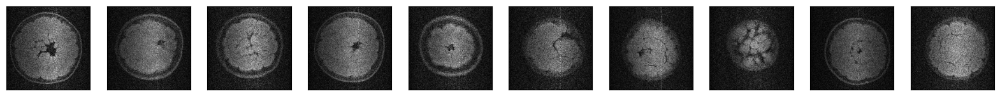

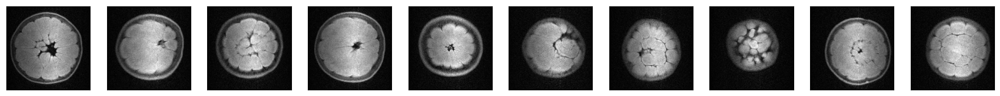

In [26]:
n = 10
plt.figure(figsize=(20, 10))
for i in range(1, n + 1):
    ax = plt.subplot(1, n, i)
    plt.imshow(x_train_noisy[i].reshape(images.shape[1], images.shape[1]))
    plt.gray()
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()

n = 10
plt.figure(figsize=(20, 10))
for i in range(1, n + 1):
    ax = plt.subplot(1, n, i)
    plt.imshow(x_train[i].reshape(images.shape[1], images.shape[1]))
    plt.gray()
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()

## Inhomogeneidades

In [27]:
import SimpleITK as sitk

https://www.programcreek.com/python/example/96385/SimpleITK.sitkFloat32

http://simpleitk.org/SimpleITK-Notebooks/01_Image_Basics.html

In [28]:
def inhomogeneidades(x_train):
    images_inho = []
    for i in range(x_train.shape[0]):
        inputImage = sitk.GetImageFromArray(x_train[i,:,:,0], isVector=True)

        selectCastFilter = sitk.VectorIndexSelectionCastImageFilter()
        selectCastFilter.SetIndex(0)
        selectCastFilter.SetOutputPixelType(sitk.sitkFloat32)
        inputImage2 = selectCastFilter.Execute(inputImage)
        inputImage = sitk.Cast(inputImage2, sitk.sitkFloat32)

        corrector = sitk.N4BiasFieldCorrectionImageFilter()
        # corrector.SetMaximumNumberOfIterations(10)

        output = corrector.Execute(inputImage)
        nda = sitk.GetArrayFromImage(output)
        # normalize the data(zero mean and unit variance)
        images_inho.append(nda)

    x_train = np.asarray(images_inho)
    x_train = x_train.reshape(-1, x_train.shape[1], x_train.shape[2],1)
    x_train = x_train.astype('float64')
    print(x_train.shape)
    return x_train

In [29]:
#(Cuesta un rato ejecutar esta celda)
if inhomogeneidades_var == 'si':
    #Time
    start_time = datetime.now() 
    
    x_train = inhomogeneidades(x_train)
    x_train_noisy = inhomogeneidades(x_train_noisy)
    x_test = inhomogeneidades(x_test)
    x_test_noisy = inhomogeneidades(x_test_noisy)
    
    #Time
    print(" ")
    print('Time elapsed (hh:mm:ss.ms) {}'.format(datetime.now() - start_time))

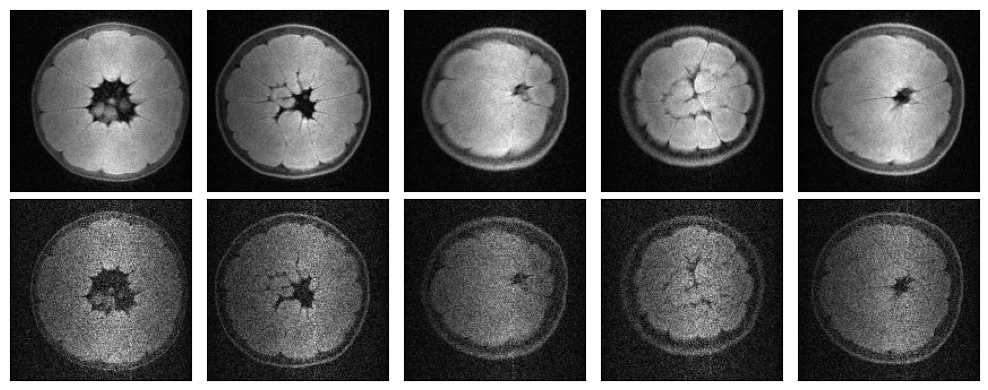

In [30]:
n = 5

fig, axs = plt.subplots(2,n, figsize=(10,4))
for i in range(0, n):
    axs[0, i].imshow((x_train[i].reshape(images.shape[1], images.shape[1])))
    axs[0, i].get_xaxis().set_visible(False)
    axs[0, i].get_yaxis().set_visible(False)   

    axs[1, i].imshow(x_train_noisy[i].reshape(images.shape[1], images.shape[1]))
    axs[1, i].get_xaxis().set_visible(False)
    axs[1, i].get_yaxis().set_visible(False)  
    
#plt.subplots_adjust(top = 0.2, bottom=0.01, hspace=-0.3, wspace=0.1)
fig.tight_layout()
plt.show()

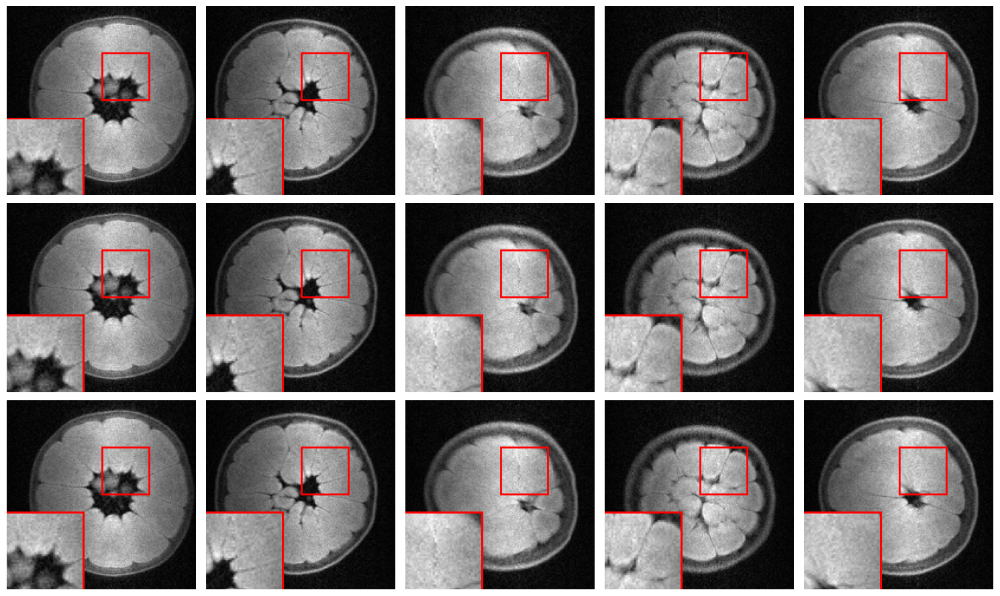

In [31]:
utils.show_windows_image(x_train, x_train, x_train)

In [32]:
#utils.show_windows_image(images, images_noise, images_noise)

## BM4D

In [33]:
roi = 20

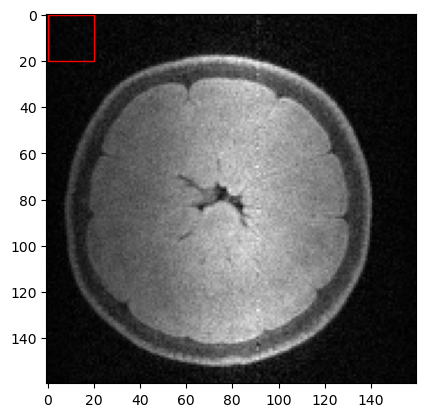

In [34]:
# Create figure and axes
fig, ax = plt.subplots()

# Display the image
ax.imshow(x_train[24,:,:,0])

# Create a Rectangle patch
rect = patches.Rectangle((0, 0), roi, roi, linewidth=1, edgecolor='r', facecolor='none')

# Add the patch to the Axes
ax.add_patch(rect)

plt.show()

In [35]:
print(x_train.shape)
print(x_train[:,0:roi,0:roi,0].shape)

(576, 160, 160, 1)
(576, 20, 20)


In [36]:
#(Cuesta un rato ejecutar esta celda)
if BM4D == 'si':
    #Time
    start_time = datetime.now()
    
    x_train = bm4d(x_train[:,:,:,0], sigma_psd=numpy.std(x_train[:,0:roi,0:roi,0], axis=0))
    x_train = x_train.reshape(-1, x_train.shape[1], x_train.shape[2],1)
    x_test = bm4d(x_test[:,:,:,0], sigma_psd=numpy.std(x_test[:,0:roi,0:roi,0], axis=0))
    x_test = x_test.reshape(-1, x_test.shape[1], x_test.shape[2],1)
    
    #Time
    print(" ")
    print('Time elapsed (hh:mm:ss.ms) {}'.format(datetime.now() - start_time))

KeyboardInterrupt: 

In [ ]:
n = 5
z = 20
fig, axs = plt.subplots(2,n, figsize=(10,4))
for i in range(0, n):
    axs[0, i].imshow((x_train[i+z].reshape(images.shape[1], images.shape[1])))
    axs[0, i].get_xaxis().set_visible(False)
    axs[0, i].get_yaxis().set_visible(False)   

    axs[1, i].imshow(x_train_noisy[i+z].reshape(images.shape[1], images.shape[1]))
    axs[1, i].get_xaxis().set_visible(False)
    axs[1, i].get_yaxis().set_visible(False)  
    
#plt.subplots_adjust(top = 0.2, bottom=0.01, hspace=-0.3, wspace=0.1)
#fig.tight_layout()
plt.show()

In [ ]:
utils.show_windows_image(x_train, x_train, x_train)

In [ ]:
print(x_train.shape)
print(x_train_noisy.shape)
print(x_test.shape)
print(x_test_noisy.shape)

In [ ]:
raise

## Save Preprocess

In [ ]:
#np.save('../save_images/augmentation/n_scans_1/bm4d_and_no_inhom/x_train', x_train)
#np.save('../save_images/augmentation/n_scans_1/bm4d_and_no_inhom/x_train_noisy', x_train_noisy)
#np.save('../save_images/augmentation/n_scans_1/bm4d_and_no_inhom/x_test', x_test)
#np.save('../save_images/augmentation/n_scans_1/bm4d_and_no_inhom/x_test_noisy', x_test_noisy)